# Stable Conceptualizer - Stable Diffusion using learned concepts

The Stable Conceptualizer enables you to use pre-learned concepts on Stable Diffusion via textual-inversion using 🤗 Hugging Face [🧨 Diffusers library](https://github.com/huggingface/diffusers).

![Textual Inversion example](https://textual-inversion.github.io/static/images/editing/colorful_teapot.JPG)

Navigate the [library of pre-learned concepts](https://huggingface.co/sd-concepts-library) here. For teaching the model new concepts using Textual Inversion, [use this notebook](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/sd_textual_inversion_training.ipynb).


# Deep Dive: Textual Inversion & Guided Sampling

## 1. Concepts: Textual Inversion in Diffusion Models
**Textual Inversion** is a technique for capturing novel concepts from a small set of images. It does this by finding new pseudo-words (tokens) in the embedding space of a pre-trained text-to-image model, like **Stable Diffusion**.

*   **The Core Idea**: Instead of fine-tuning the entire Diffusion model (UNet), we only learn a new 'token' embedding. This token acts as a pointer to a specific artistic style, object, or character.
*   **Embedding Space**: By 'inverting' the process, we find a vector in the CLIP text encoder space that, when used in a prompt, reconstructs the visual concepts it was trained on.
*   **Efficiency**: This allows us to inject personalized concepts into the model without requiring massive compute or changing the model weights themselves.

## 2. Personalized Styles in this Notebook
We have integrated 5+ diverse styles from the **Stable Diffusion Concepts Library**. You can invoke these styles using the `<style>` placeholder in your prompts.

| Style Name | Description | token |
| :--- | :--- | :--- |
| **Cat Toy** | Plastic, cute, toy-like aesthetic | `<cat-toy>` |
| **Seletti** | Design-heavy, porcelain/ceramic style | `<seletti>` |
| **Madhubani Art** | Traditional Indian folk art from Mithila | `<madhubani-art>` |
| **Chucky** | Horror-themed character style | `<chucky>` |
| **Indian Watercolor** | Soft, expressive watercolor portraits | `<indian-watercolor-portraits>` |
| **Anime Boy** | Clean, cel-shaded anime character style | `<anime-boy>` |

## 3. Concept: Artistic Guided Sampling
While Classifier-Free Guidance (CFG) follows the text prompt, **Guided Sampling** allows us to steer the model towards specific visual properties using extra 'loss' gradients during the sampling loop.

### Why use Guidance?
Standard generation can sometimes lack 'pop' or specific lighting characteristics. By calculating a loss on the intermediate decoded images at each step, we can nudge the latents to maximize certain features:

1.  **Contrast Guidance**: Pushes pixels toward extremes (black/white), creating dramatic lighting and deep shadows.
2.  **Complexity Guidance**: Uses edge-detection filters to favor high-frequency detail, making images look sharper and more intricate.
3.  **Vibrancy Guidance**: Maximizes color channel variance, forcing the model to favor vivid, punchy colors over muted or grayscale tones.

## 4. Implementation & Reproducibility
To truly observe the power of guidance, we use **fixed seeds** through `torch.Generator`.

*   **The Baseline Problem**: If we change the guidance scale and the noise also changes, we can't tell if the improvement is luck or the guidance working.
*   **The Solution**: By locking the seed, we ensure the initial noise and the model's 'path' are identical. Any variation in the output is solely the result of our guidance steering the diffusion process.

The function `generate_with_multi_loss` implements a custom version of the PNDM/DDIM loop that injects these gradients at every step.

---

## Guided Sampling Implementation (Code)
Below are the technical implementations of the loss functions and the custom sampling loop described above.

In [ ]:
def contrast_loss(images):
    return -torch.mean((images - 0.5) ** 2)

def complexity_loss(images):
    diff_h = torch.abs(images[:, :, 1:, :] - images[:, :, :-1, :])
    diff_v = torch.abs(images[:, :, :, 1:] - images[:, :, :, :-1])
    return torch.mean(diff_h) + torch.mean(diff_v)

def vibrancy_loss(images):
    means = torch.mean(images, dim=1, keepdim=True)
    return -torch.mean((images - means) ** 2)

In [ ]:
def generate_with_multi_loss(prompt, pipe, guidance_scale=7.5, contrast_scale=0.0, complexity_scale=0.0, vibrancy_scale=0.0, num_inference_steps=50, generator=None, latents=None):
    device = pipe.device
    text_input = pipe.tokenizer(prompt, padding='max_length', max_length=pipe.tokenizer.model_max_length, truncation=True, return_tensors='pt')
    text_embeddings = pipe.text_encoder(text_input.input_ids.to(device))[0]
    uncond_input = pipe.tokenizer([''], padding='max_length', max_length=text_input.input_ids.shape[-1], return_tensors='pt')
    uncond_embeddings = pipe.text_encoder(uncond_input.input_ids.to(device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    if latents is None: latents = torch.randn((1, pipe.unet.config.in_channels, 512 // 8, 512 // 8), generator=generator, device=device, dtype=pipe.unet.dtype)
    pipe.scheduler.set_timesteps(num_inference_steps)
    latents = latents * pipe.scheduler.init_noise_sigma
    for t in tqdm.notebook.tqdm(pipe.scheduler.timesteps):
        latent_model_input = torch.cat([latents] * 2)
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)
        with torch.no_grad(): noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        if contrast_scale > 0 or complexity_scale > 0 or vibrancy_scale > 0:
            latents = latents.detach().requires_grad_(True)
            image = pipe.vae.decode(1 / 0.18215 * latents).sample
            image = (image / 2 + 0.5).clamp(0, 1)
            loss = 0
            if contrast_scale > 0: loss += contrast_loss(image) * contrast_scale
            if complexity_scale > 0: loss -= complexity_loss(image) * complexity_scale
            if vibrancy_scale > 0: loss += vibrancy_loss(image) * vibrancy_scale
            cond_grad = torch.autograd.grad(loss, latents)[0]
            latents = latents.detach() - cond_grad
        latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    with torch.no_grad(): image = pipe.vae.decode(1 / 0.18215 * latents).sample
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(0, 2, 3, 1).numpy()
    return pipe.numpy_to_pil(image)

## Initial setup

In [ ]:
#@title Install the required libs
%pip install -qq --upgrade --force-reinstall diffusers transformers ftfy accelerate huggingface_hub
#%pip install -qq --upgrade --force-reinstall diffusers transformers ftfy accelerate huggingface_hub
#%pip install -q huggingface_hub==0.34.0 fsspec==2025.3.0 requests==2.32.4 --force-reinstall
#%pip install -q jax==0.5.3 jaxlib==0.5.3 -f https://storage.googleapis.com/jax-releases/jax_cuda_releases.html --force-reinstall # Install compatible jax versions

In [1]:
# === MONKEYPATCH START ===
# 1. Fix tqdm Jupyter/Thread Error (Limit to text bars)
import sys
try:
    import tqdm
    if not hasattr(tqdm, '_is_patched'):
        import tqdm.notebook
        import tqdm.std
        tqdm.notebook.tqdm = tqdm.std.tqdm
        tqdm.notebook.trange = tqdm.std.trange
        # Patch auto if loaded
        if 'tqdm.auto' in sys.modules:
            sys.modules['tqdm.auto'].tqdm = tqdm.std.tqdm
            sys.modules['tqdm.auto'].trange = tqdm.std.trange
        tqdm._is_patched = True
except ImportError:
    pass

# 2. Fix Windows Symlink Permissions (WinError 1314) for HuggingFace Hub
import os
import shutil
try:
    from huggingface_hub import file_download
    # Save original if not already saved
    if not hasattr(file_download, '_original_create_symlink'):
        file_download._original_create_symlink = file_download._create_symlink

    def patched_create_symlink(src, dst, new_blob=False):
        try:
            file_download._original_create_symlink(src, dst, new_blob)
        except OSError as e:
            if getattr(e, 'winerror', 0) == 1314: # A required privilege is not held
                # Fallback to copy
                # print(f"Info: Symlink failed (WinError 1314). Copying {src} -> {dst}")
                if os.path.isdir(src):
                    shutil.copytree(src, dst)
                else:
                    shutil.copy2(src, dst)
            else:
                raise

    # Apply patch
    file_download._create_symlink = patched_create_symlink
except ImportError:
    pass
# === MONKEYPATCH END ===
#@title Login to the Hugging Face Hub
from huggingface_hub import notebook_login
notebook_login()

In [2]:
#@title Import required libraries
#%pip install -qq --upgrade --force-reinstall diffusers transformers ftfy accelerate huggingface_hub

import os
os.environ['HF_HUB_DISABLE_PROGRESS_BARS'] = '1' # Fix for Jupyter threading issue
import tqdm.notebook
# Monkeypatch tqdm notebook to use standard text-based progress bar to avoid Widget Threading Error
tqdm.notebook.tqdm = tqdm.tqdm
tqdm.notebook.trange = tqdm.trange
import torch

import PIL
from PIL import Image

from diffusers import StableDiffusionPipeline
from transformers import CLIPFeatureExtractor, CLIPTextModel, CLIPTokenizer

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

---

## Run Stable Diffusion with pre-trained Learned Concepts




In [5]:
#@markdown `pretrained_model_name_or_path` which Stable Diffusion checkpoint you want to use. This should match the one used for training the embeddings.
pretrained_model_name_or_path = "CompVis/stable-diffusion-v1-4" #@param {type:"string"}

In [19]:
#@title Load your concept here
#@markdown Enter the `repo_id` for a concept you like (you can find pre-learned concepts in the public [SD Concepts Library](https://huggingface.co/sd-concepts-library))
repo_id_embeds1 = "sd-concepts-library/cat-toy" #@param {type:"string"}
repo_id_embeds2 = "sd-concepts-library/seletti" #@param {type:"string"}
repo_id_embeds3 = "sd-concepts-library/madhubani-art" #@param {type:"string"}
repo_id_embeds4 = "sd-concepts-library/chucky" #@param {type:"string"}
repo_id_embeds5 = "sd-concepts-library/indian-watercolor-portraits" #@param {type:"string"}
repo_id_embeds6 = "sd-concepts-library/anime-boy" #@param {type:"string"}
#repo_id_embeds6 = "sd-concepts-library/mtl-longsky" #@param {type:"string"}
#repo_id_embeds6 = "sd-concepts-library/lego-astronaut" #@param {type:"string"}

# Define 6 different seeds (one for each style)
seeds = [42, 123, 456, 789, 1024, 1560]




In [17]:
#@title Load the Stable Diffusion pipeline
pipe = StableDiffusionPipeline.from_pretrained(
    pretrained_model_name_or_path,
    torch_dtype=torch.float16
).to("cuda")

Loading pipeline components...: 100%|██████████| 7/7 [00:12<00:00,  1.83s/it]


## Style 1

In [81]:
#@title Load the concept into pipeline
pipe.load_textual_inversion(repo_id_embeds1)

100%|██████████| 50/50 [00:04<00:00, 11.48it/s]


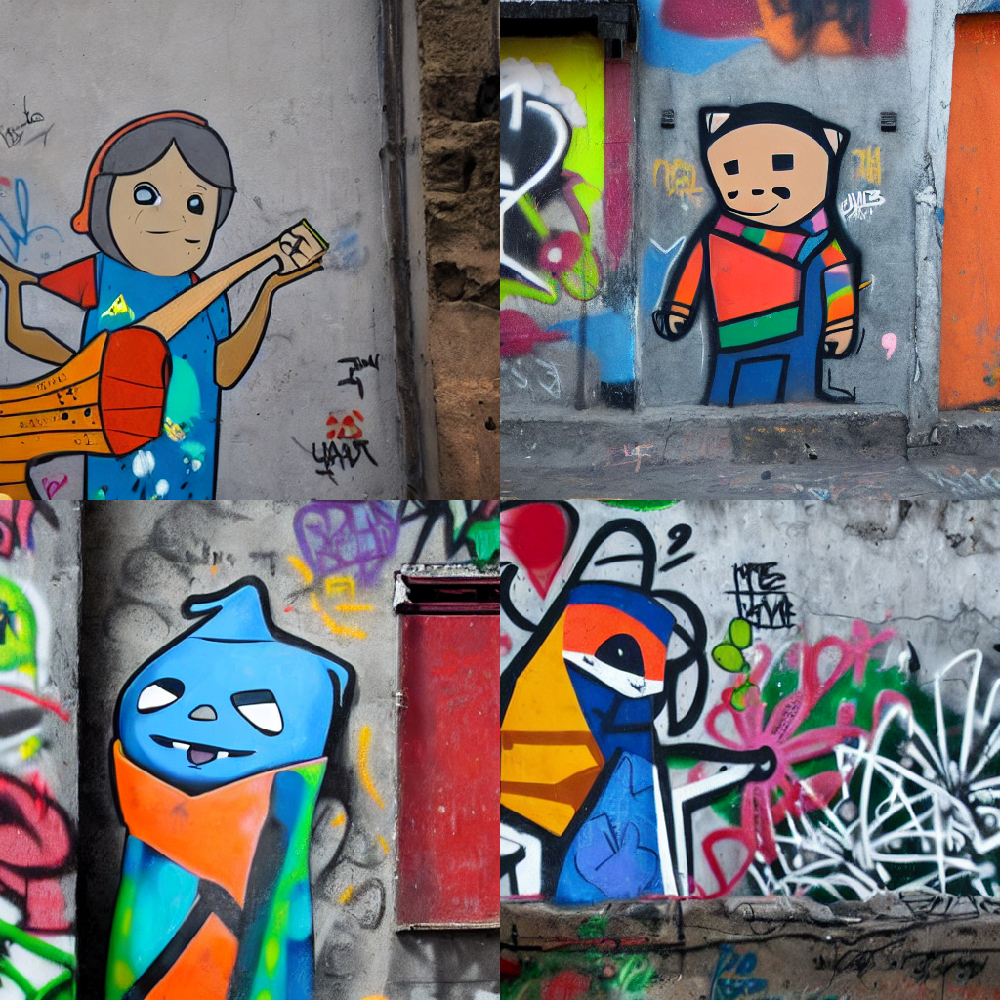

In [82]:
#@title Run the Stable Diffusion pipeline
#@markdown Don't forget to use the placeholder token in your prompt

prompt = "a grafitti in a favela wall with a <cat-toy> on it" #@param {type:"string"}

num_samples = 2 #@param {type:"number"}
num_rows = 2 #@param {type:"number"}
generator = torch.Generator(device="cuda").manual_seed(seeds[0])
all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5,generator=generator).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

## Style 2

100%|██████████| 50/50 [00:04<00:00, 11.44it/s]


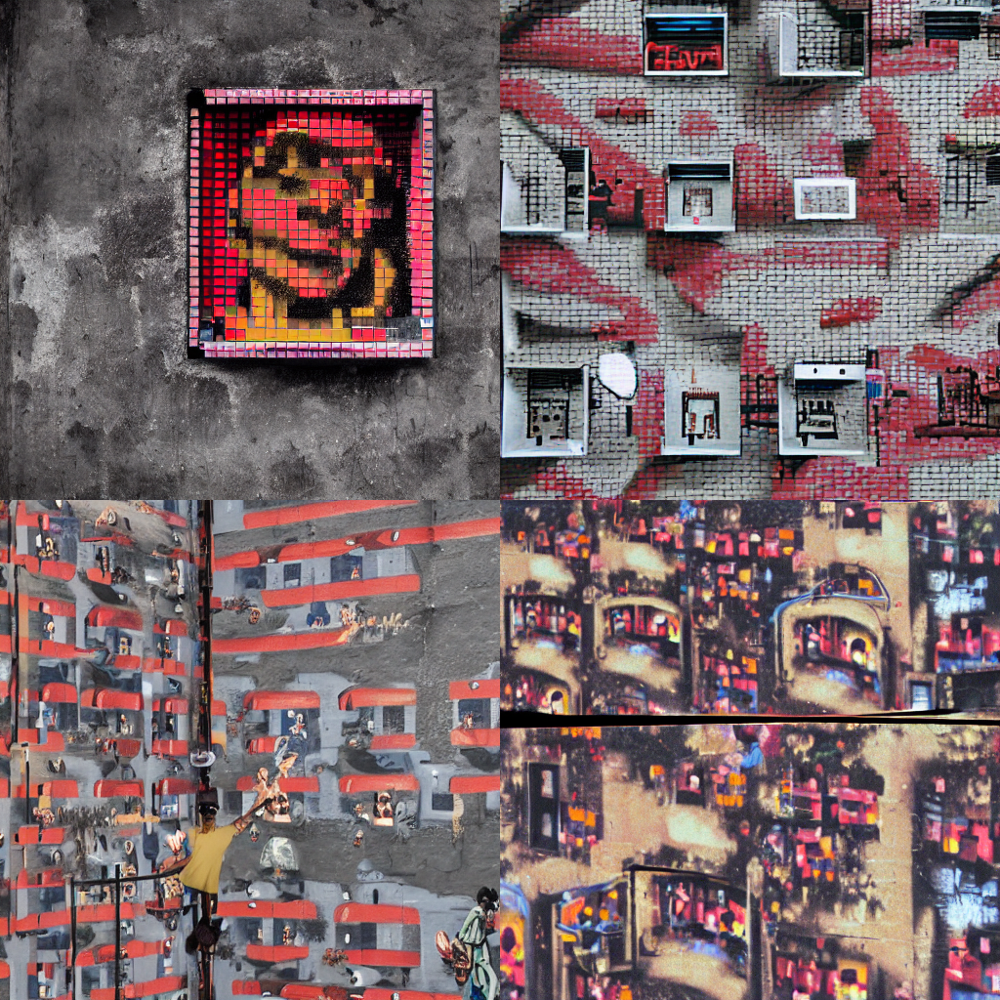

In [83]:
#@title Load the concept into pipeline
pipe.load_textual_inversion(repo_id_embeds2)

prompt = "a grafitti in a favela wall with a <Seletti> on it" #@param {type:"string"}

num_samples = 2 #@param {type:"number"}
num_rows = 2 #@param {type:"number"}

generator = torch.Generator(device="cuda").manual_seed(seeds[1])

all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5,generator=generator).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

## Style 3

100%|██████████| 50/50 [00:04<00:00, 11.35it/s]


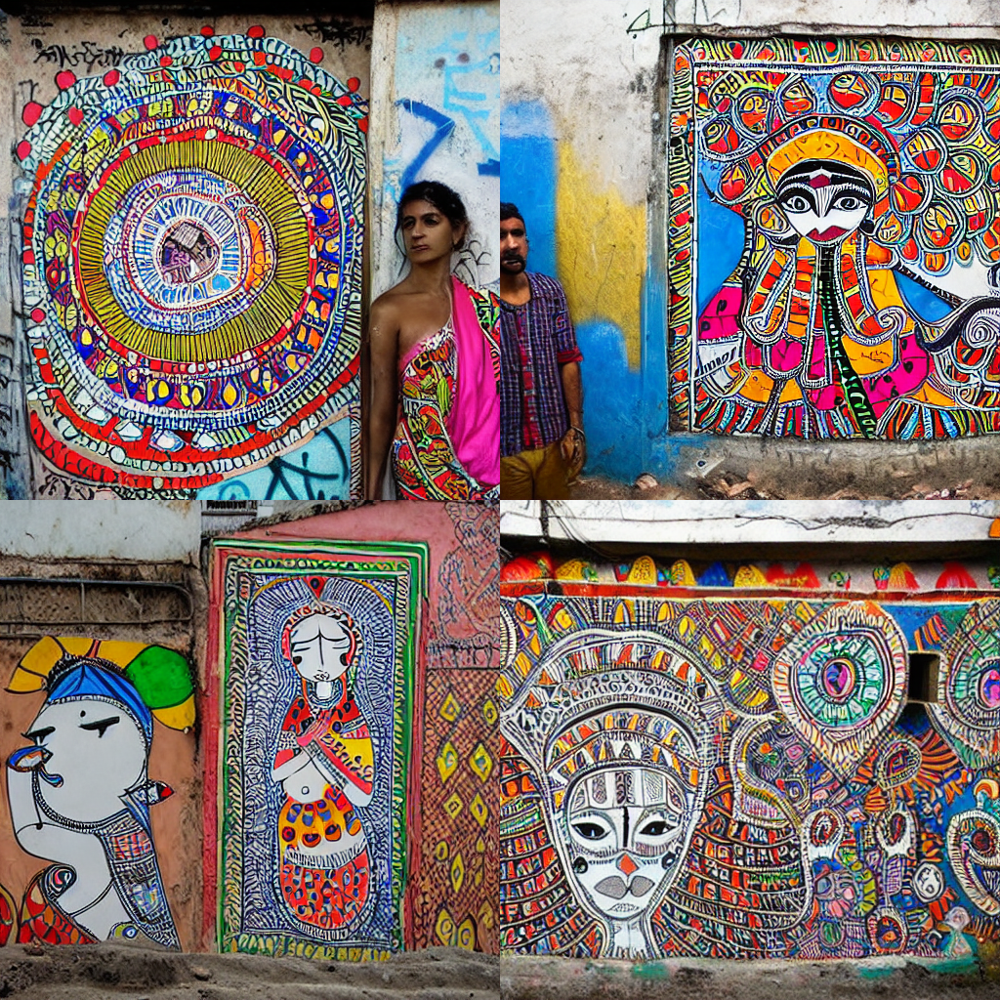

In [84]:
#@title Load the concept into pipeline
pipe.load_textual_inversion(repo_id_embeds3)

prompt = "a grafitti in a favela wall with a <madhubani-art> on it" #@param {type:"string"}

num_samples = 2 #@param {type:"number"}
num_rows = 2 #@param {type:"number"}
generator = torch.Generator(device="cuda").manual_seed(seeds[2])
all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5,generator=generator).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

## Style 4

100%|██████████| 50/50 [00:04<00:00, 11.35it/s]


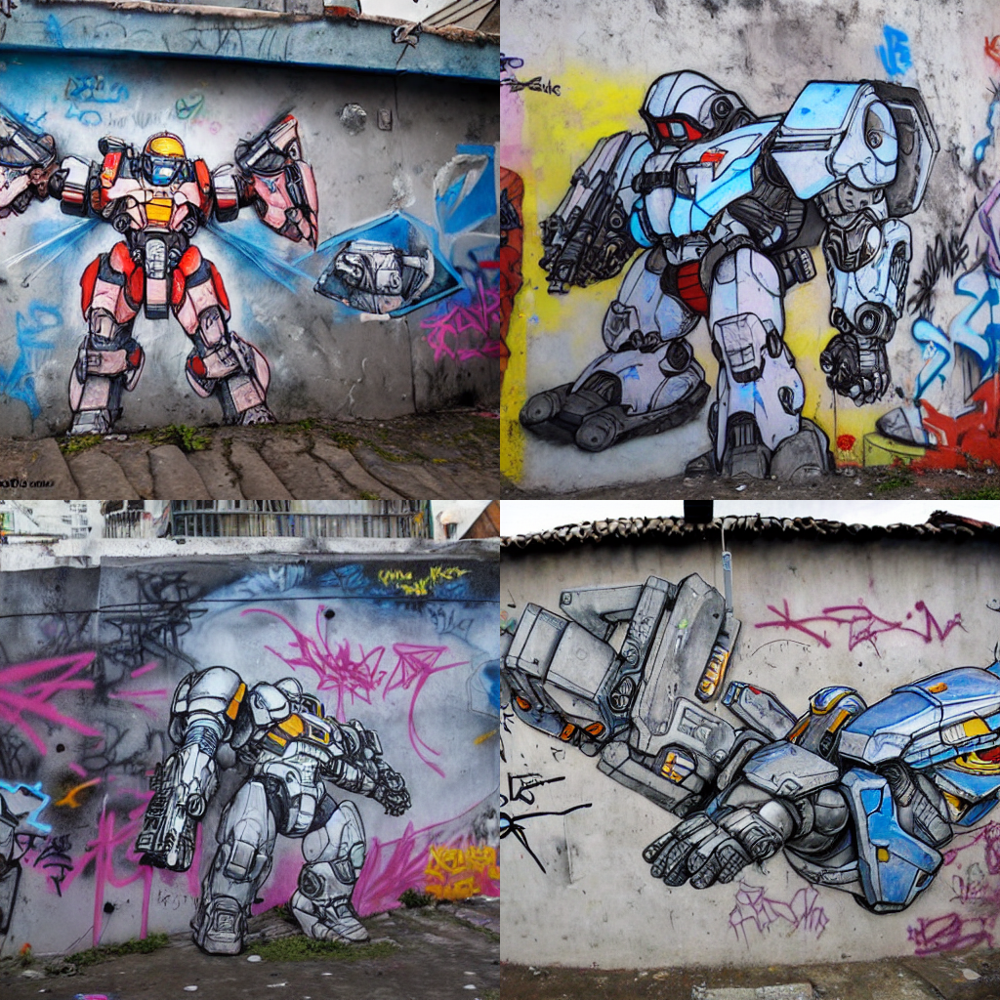

In [85]:
#@title Load the concept into pipeline
pipe.load_textual_inversion(repo_id_embeds4)

prompt = "a grafitti in a favela wall with a <merc> on it" #@param {type:"string"}

num_samples = 2 #@param {type:"number"}
num_rows = 2 #@param {type:"number"}
generator = torch.Generator(device="cuda").manual_seed(seeds[3])
all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5,generator=generator).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

## Style 5

100%|██████████| 50/50 [00:04<00:00, 11.34it/s]


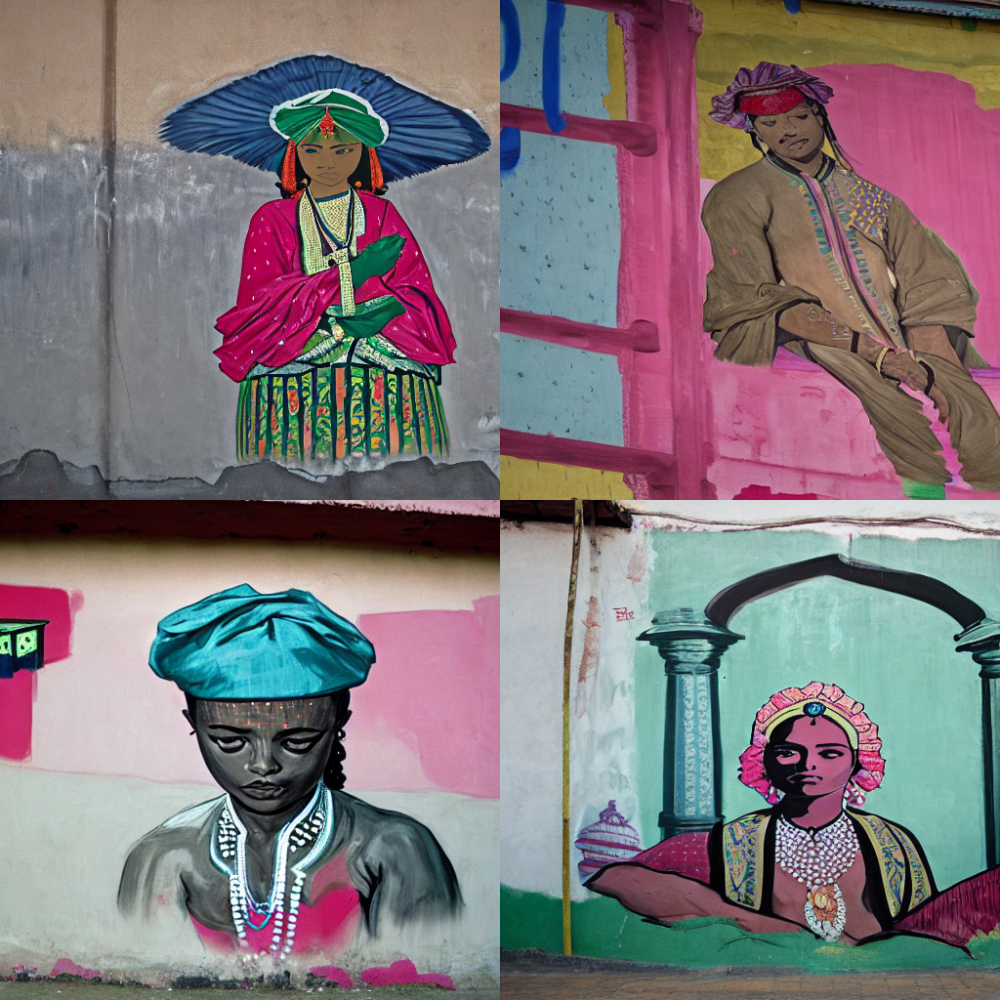

In [86]:
#@title Load the concept into pipeline
pipe.load_textual_inversion(repo_id_embeds5)

prompt = "a grafitti in a favela wall with a <watercolor-portrait> on it" #@param {type:"string"}

num_samples = 2 #@param {type:"number"}
num_rows = 2 #@param {type:"number"}
generator = torch.Generator(device="cuda").manual_seed(seeds[4])
all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5,generator=generator).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

## Style 6

100%|██████████| 50/50 [25:07<00:00, 30.14s/it]


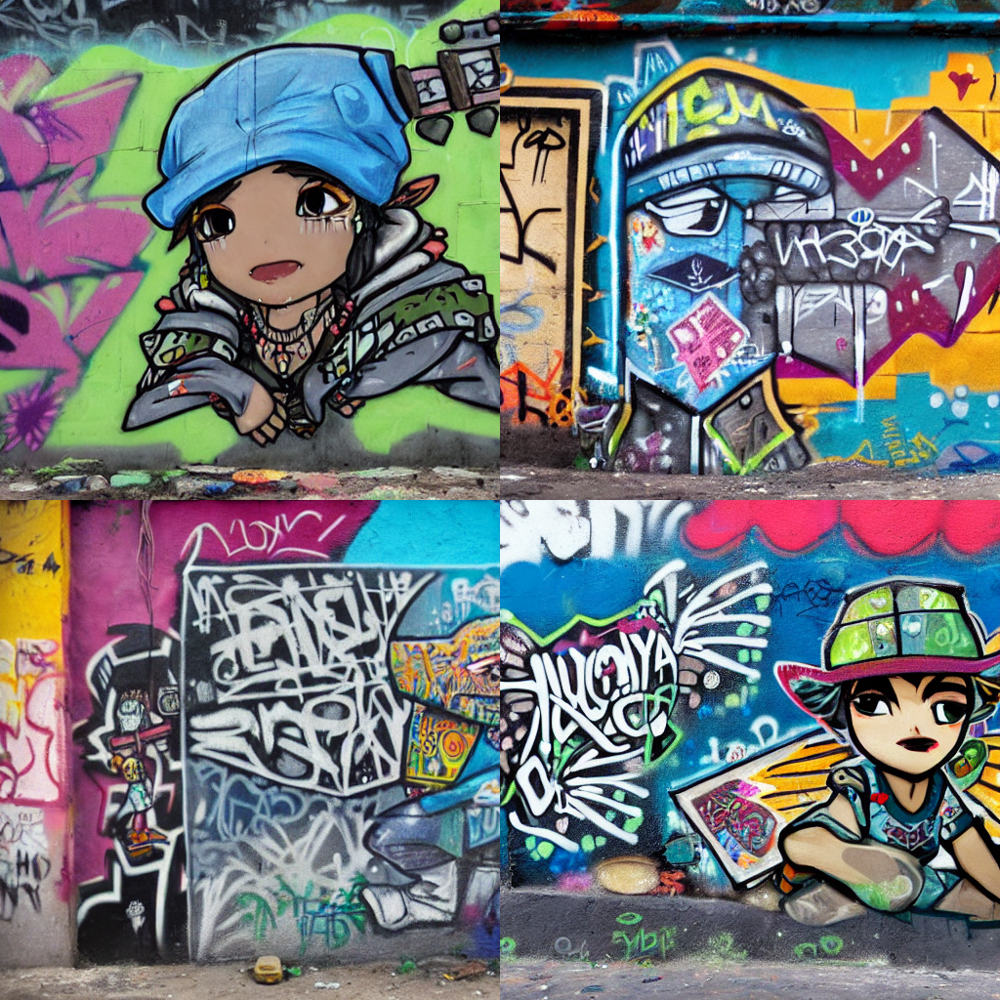

In [21]:
#@title Load the concept into pipeline
pipe.load_textual_inversion(repo_id_embeds6)


#prompt = " Hundreds of <lego-astronaut> walking in time square each wearing nike shoes" #@param {type:"string"}
prompt = "a grafitti in a favela wall with a <myAItestShota> on it" #@param {type:"string"}
#prompt = "a grafitti in a favela wall with a <mtl-longsky> on it" #@param {type:"string"}#

num_samples = 2 #@param {type:"number"}
num_rows = 2 #@param {type:"number"}
generator = torch.Generator(device="cuda").manual_seed(seeds[5])
all_images = []
for _ in range(num_rows):
    images = pipe(prompt, num_images_per_prompt=num_samples, num_inference_steps=50, guidance_scale=7.5,generator=generator).images
    all_images.extend(images)

grid = image_grid(all_images, num_samples, num_rows)
grid

## Loss based Guidance

Generating Baseline (No Guidance)...


100%|██████████| 51/51 [00:02<00:00, 18.00it/s]


Generating with Vibrancy Guidance (scale=500)...


100%|██████████| 51/51 [01:17<00:00,  1.53s/it]


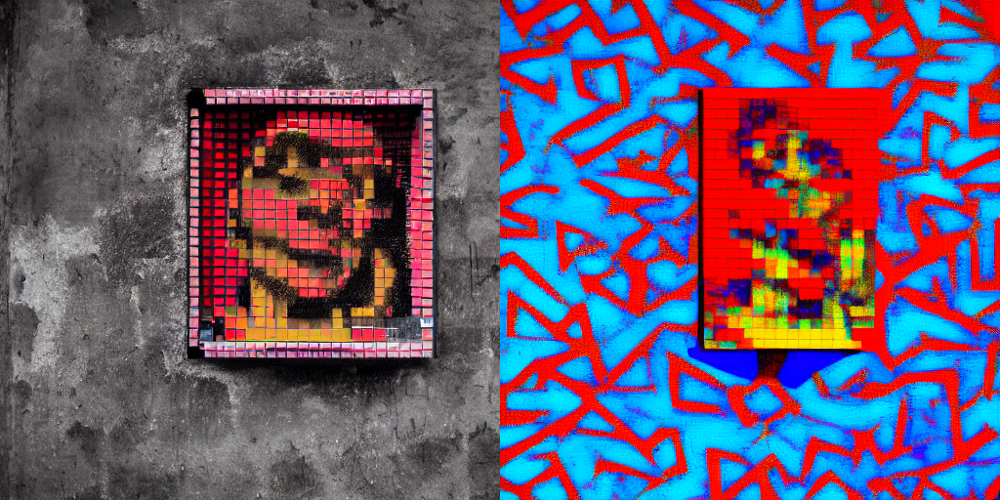

Left: Baseline, Right: Vibrancy


In [ ]:
# Test Multi-Guidance (Baseline vs Vibrancy)
prompt = "a grafitti in a favela wall with a <Seletti> on it" 
#prompt = "a landscape of a crystal lake at sunset in style of <Seletti>"
generator = torch.Generator(device="cuda").manual_seed(seeds[1])

print("Generating Baseline (No Guidance)...")
img_base = generate_with_multi_loss(prompt, pipe, contrast_scale=0, complexity_scale=0, generator=generator)

print("Generating with Vibrancy Guidance (scale=500)...")
generator = torch.Generator(device="cuda").manual_seed(seeds[1])
img_vib = generate_with_multi_loss(prompt, pipe, vibrancy_scale=500, generator=generator)

#print("Generating with Complexity Guidance (scale=1500)...")
#generator = torch.Generator(device="cuda").manual_seed(seeds[3])
#img_complex = generate_with_multi_loss(prompt, pipe, contrast_scale=0, complexity_scale=1500, generator=generator)

#grid = image_grid([img_base[0], img_contrast[0], img_complex[0]], 1, 3)
grid = image_grid([img_base[0], img_vib[0]], 1, 2)
display(grid)
print("Left: Baseline, Right: Vibrancy")